# Code to Find Asteroids in an Image

### Preparing Coding Environment by Installing Libraries

In [40]:
### Importing Required Libraries ###
import numpy as np
from astropy.io import fits
import urllib as url
import cv2
import os
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from tqdm.notebook import tqdm
import sys
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astroquery.mpc import MPC
from pprint import pprint
from astroquery.vizier import Vizier 
import astropy.units as u 
import astropy.coordinates as coord
#import pyplate


## Step 1: Set Up 

-----------------------------------------------------------------------------------------------------------------------------

In [41]:
# Commonly Used Functions for the Lab


# Function to read the FITS file

def read_file(filename, folder):

    
    #Join the filename to the folder path
    path = os.path.join(folder, filename)
    
    #Read the fits file
    hdulist = fits.open(path)
    
    #Extract relevant data products
    hdr, data = hdulist[0].header, hdulist[0].data
    
    center_of_field = [hdr['RA'], hdr['DEC']]
    
    #Display to user the observation date-time and location
    print("DATE AND TIME OF OBSERVATION: " + hdr['DATE-OBS'])
    
    print("APPROXIMATE CENTER OF THE OBSERVING FIELD (RA/DEC):", center_of_field)
    print()
    return hdr, data, center_of_field


# Function to search the USNO-B1 database for known stars in the field of view

def search_usno(ra_deg, dec_deg, fov_am):# RA/Dec in decimal degrees/J2000.0 FOV in arc min.

    #Request to open the USNO-B1 catalog from the internet
    str1 = 'http://webviz.u-strasbg.fr/viz-bin/asu-tsv/?-source=USNO-B1'
    str2 = '&-c.ra={:4.6f}&-c.dec={:4.6f}&-c.bm={:4.7f}/{:4.7f}&-out.max=unlimited'.format(ra_deg, dec_deg, fov_am, fov_am)
    f = url.request.urlopen(str1+str2)
    
    #   Read from the object, storing the page's contents in 's'.
    s = f.read()
    f.close()
    sl =s.splitlines()
    sl = sl[36:-1]    # get rid of header
    
    name = np.array([]) # Name of the Object
    rad = np.array([])  # RA in degrees
    ded = np.array([])  # DEC in degrees
    rmag = np.array([]) # Magnitude of the Object
    
    for k in sl:
        kw = k.decode().split('\t')
        try:
            float(kw[1])
        except:
            continue
        name = np.append(name,kw[0])
        rad = np.append(rad,float(kw[1]))
        ded = np.append(ded,float(kw[2]))
        if kw[12] != '     ': # deal with case where no mag is reported 
            rmag = np.append(rmag,float(kw[12])) 
        else:
            rmag = np.append(rmag,30.0) 
            
    return name, rad, ded, rmag

# Function to transform celestial coordinatoes of stars from USNO-B1 database to CCD pixel coordinates

def get_XY(alpha, delta, alpha0, delta0):

    #Convert all degree quantities to radians
    print(type(alpha))
    alpha = np.deg2rad(alpha)
    delta = np.deg2rad(delta)
    alpha0 = np.deg2rad(alpha0)
    delta0 = np.deg2rad(delta0)
    
    #Compute the projection relative to the center of the field
    X = np.cos(delta)*np.sin(alpha - alpha0)
    Y = np.sin(delta0)*np.cos(delta)*np.cos(alpha - alpha0) - np.cos(delta0)*np.sin(delta)
    norm = np.cos(delta0)*np.cos(delta)*np.cos(alpha - alpha0)+np.sin(delta0)*np.sin(delta)
    
    return X/norm, -1*Y/norm

# Function to help finding centroids of stars in the CCD Image

def approximate_transform(reference_stars, image_shape, focal_length, pixel_size, center_of_field, rotation_angle):

    #Intialize an array to hold to transformed co-ordinates
    transform_reference_stars = np.empty_like(reference_stars)

    #Convert data products to the required format for computation
    #alpha0, delta0 = convert2deg(*center_of_field)
    alpha0, delta0 = center_of_field
    rotation_angle = np.deg2rad(rotation_angle)
    
    #For each star
    for i in range(reference_stars.shape[0]):

        #Extract parameters
        star = reference_stars[i,:]
        alpha, delta = star[0], star[1]

        #Project onto a plane
        X, Y = get_XY(alpha, delta, alpha0, delta0)

        #Convert to approximate CCD pixel co-ordinates
        x = focal_length*(X/pixel_size) 
        y = focal_length*(Y/pixel_size) 

        #Apply a standard rotation
        x_rot = x*np.cos(rotation_angle) - y*np.sin(rotation_angle)
        y_rot = x*np.sin(rotation_angle) + y*np.cos(rotation_angle)

        #Center values on the CCD and add to the array of transformed co-ordinates
        transform_reference_stars[i,0] = x_rot + image_shape[1]/2.0 
        transform_reference_stars[i,1] = y_rot + image_shape[0]/2.0
        
    return transform_reference_stars


### Getting Image and Header from FITS File

In [42]:
### Opening FITS files ###
img = r'C:\Users\vikas\Desktop\Space\astronametrica\August 2021\real\compleated\only known asteroids\ps1-20210806_4_XY61_p11\XY61_p11\o9432g0354o.1823733.ch.2487286.XY61.p11.fits'
file1 = fits.open(img)
file2 = fits.open('apophis2.fits')

image1 = file1[0]
image2 = file2[0]


#Getting File Header
header1 = image1.header
header2 = image2.header



### Extracting Usefull Information from FITS File ###

#Camera

NAXIS1 = image1.header['NAXIS1']
NAXIS2 = image1.header['NAXIS2']
CCDXPIXE = image1.header['PIXSIZE1']



#OBJECT


RA = image1.header['OBJCTRA']
DEC = image1.header['OBJCTDEC']
DATE = image1.header['DATE-OBS']

BINNING = image1.header['CCDSUM']

#focal = 20600 #mm
#Aperture = 2000 #mm
#Focal_Ratio = 10
#Pixel_Scale = 0.005066666666666666 #arcmin/pixel



print('DATE-OBS: ', DATE)
print('Right Ascension (hh:mm:ss): ', RA)
print('Declination (degrees: arcmin: arcsec): ', DEC)
#print('focal: ', focal)
#print('Aperture (mm): ', Aperture)
#print('Focal Ratio: ', Focal_Ratio)
print('CCD Length (pixels): ', NAXIS1)
print('CCD Width (pixels): ', NAXIS2)
CCDXPIXE = float(CCDXPIXE) / 1000
print('Pixel Width (mm): ', float(CCDXPIXE))
#print("Pixel Scale (arcmin per pixel)", Pixel_Scale)
print('BINNING: ', BINNING)

#Calculating Focal Length and the Field of View
Focal_Length = 8070.0 #mm

#FOV =  (int(NAXIS1) * (Pixel_Scale) * 2)**2 #arc-mins
FOV = 10.4
print(type(RA))
print("Focal Length (mm): ", Focal_Length)

print("Field of View (arcmin): ", FOV)

### Opening Images ###
image_data = fits.getdata(img)
image_data2 = fits.getdata('apophis2.fits')

DATE-OBS:  2021-08-06T10:55:06.783824
Right Ascension (hh:mm:ss):  22 23 27.530
Declination (degrees: arcmin: arcsec):  -11 52 36.635
CCD Length (pixels):  2423
CCD Width (pixels):  2434
Pixel Width (mm):  0.01
BINNING:  1 1
<class 'str'>
Focal Length (mm):  8070.0
Field of View (arcmin):  10.4


In [43]:
image1.header

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                   16 / number of bits per data pixel                  
NAXIS   =                    2 / number of data axes                            
NAXIS1  =                 2423 / length of data axis 1                          
NAXIS2  =                 2434 / length of data axis 2                          
BZERO   =               32768.                                                  
BSCALE  =                   1.                                                  
DATE-OBS= '2021-08-06T10:55:06.783824' /  UTC start of exposure                 
TIMESYS = 'UTC     '           / Time scale                                     
EQUINOX =                2000. /                                                
EXPTIME =                  45. /  exposure time (sec)                           
OBJCTRA = '22 23 27.530'       / RA of center of the image                      
OBJCTDEC= '-11 52 36.635'   

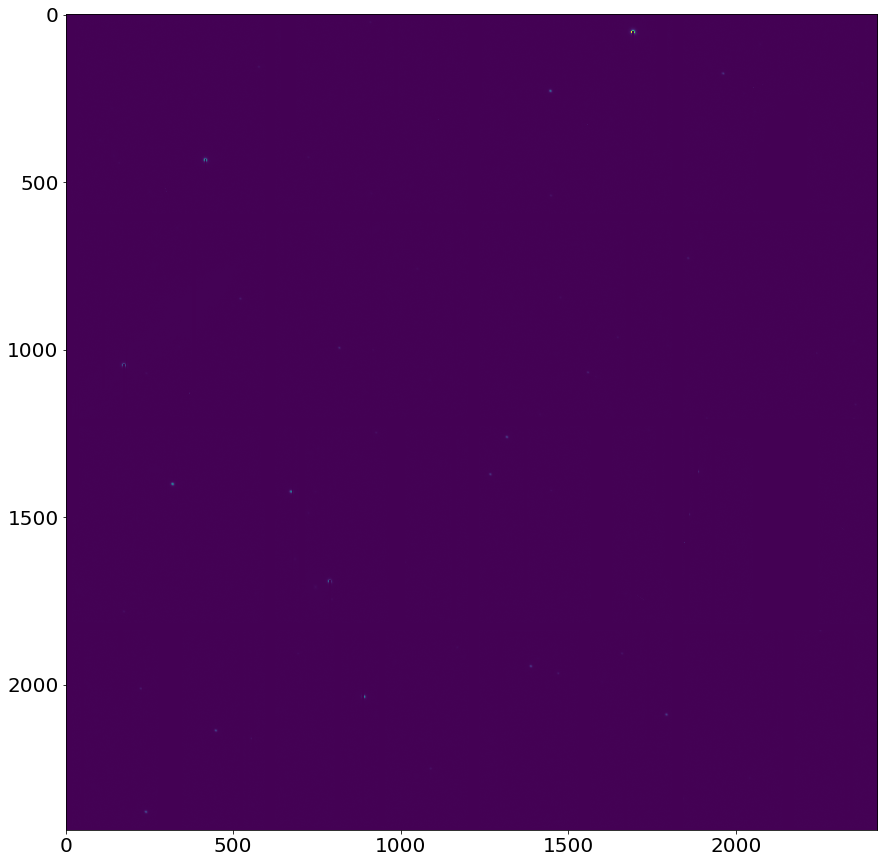

In [44]:
plt.figure(figsize=(15, 15))
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
plt.imshow(image_data)

### Scalling Images

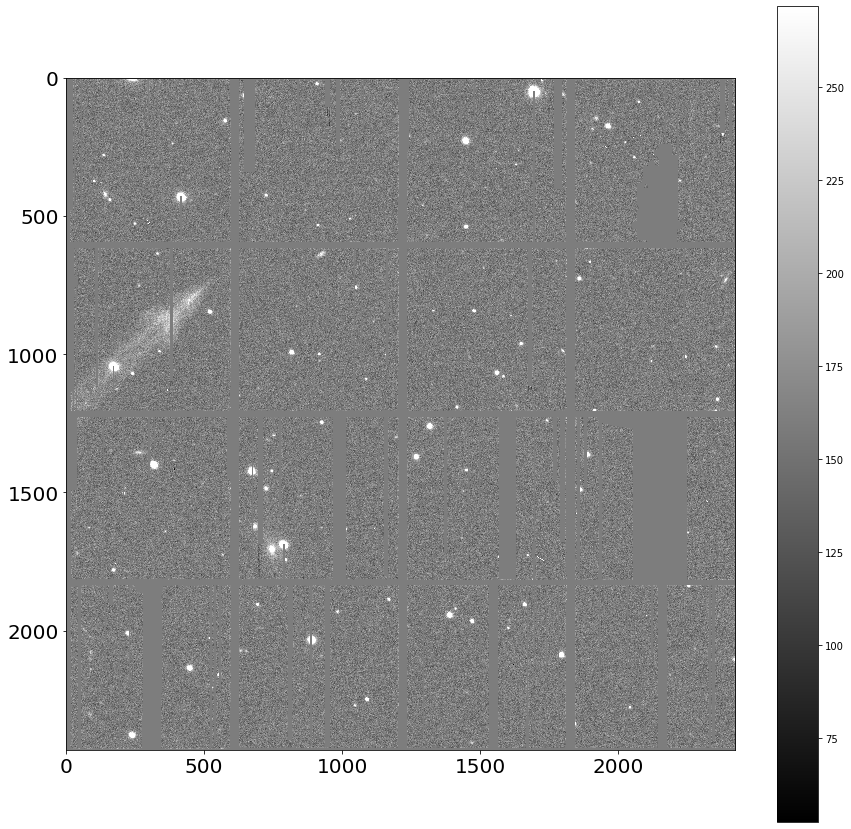

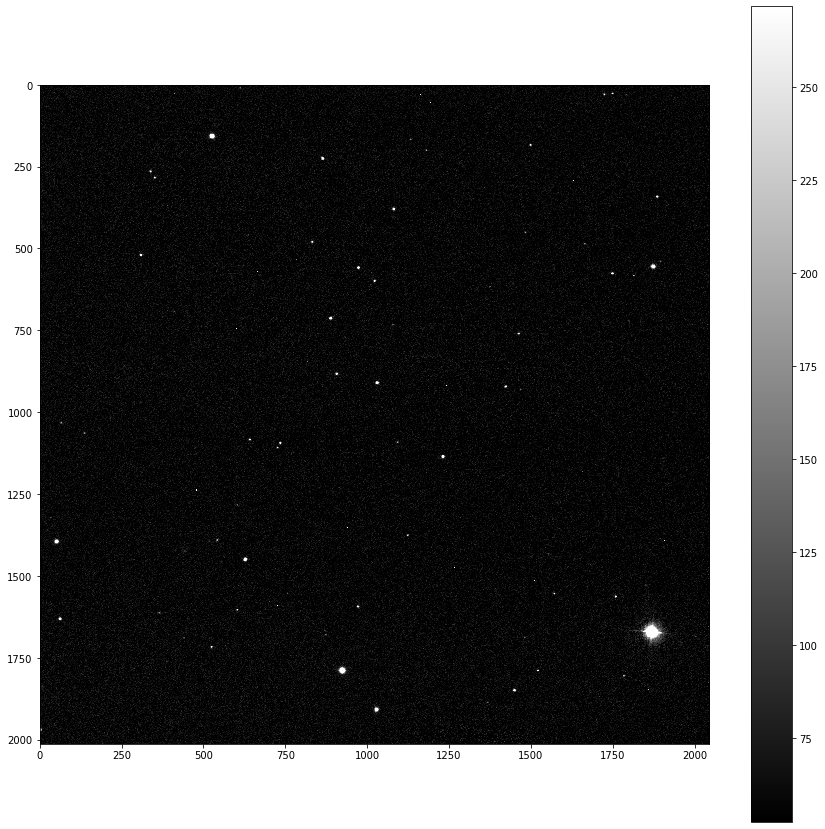

In [45]:
#scaling Image to identify Objects
import scipy.ndimage as ndimage

def show(im):
    #plt.imshow(im, cmap='gray', vmin=image_data.mean()-1*image_data.std(), vmax=image_data.mean()+1*image_data.std())
    plt.imshow(im, cmap='gray', vmin=image_data.mean()-1*image_data.std(), vmax=image_data.mean()+1*image_data.std())

plt.figure(figsize=(15, 15))
a = np.flip(image_data, axis=1)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
show(image_data)
plt.colorbar()


plt.figure(figsize=(15, 15))
show(image_data2)
plt.colorbar()

In [46]:
RA = '22 57 33.2'
DEC = '-11 52 38'

### Converting RA and DEC to Degrees

In [47]:
### Creating a Function to Convert Right Ascention(h : m : s) to Degrees ###

def RAtoDeg(ra):
    h,m,s = ra.split(" ")
    
    h = float(h)
    m = float(m)
    s = float(s)
    
    deg = (h*15) + (m/4) + (s/240)
    print(deg)
    return deg



### Creating a Function to Convert Declination (deg : arc-min : arc-sec) to Degrees ###

def DECtoDeg(dec):
    d,d2,d3 = dec.split(" ")
    
    if d[0] == '-':
        d = float(d)
        d2 = float(d2)
        d3 = float(d3)

    
        deg = d - (d2/60) - (d3/3600)
    
 
    else:    
        d = float(d)
        d2 = float(d2)
        d3 = float(d3)

    
        deg = d + (d2/60) + (d3/3600)
    print(deg)
    return deg

In [48]:
### Converting Image RA and DEC to degrees ###
RA_deg = RAtoDeg(RA)
DEC_deg = DECtoDeg(DEC)


344.3883333333333
-11.877222222222223


## Step 2: Finding Known Stars in Image

--------------------------------------------------------------------------------------------

### Querying GAIA-ER3 Catalog for Know Stars

In [49]:
import astropy.coordinates as coord
import astropy.units as u
from astropy.wcs import WCS
from astroquery.gaia import Gaia

Gaia.MAIN_GAIA_TABLE = "gaiaedr3.gaia_source"
Gaia.ROW_LIMIT = -1

coord = SkyCoord(ra=RA_deg, dec=DEC_deg, unit=(u.degree, u.degree), frame='icrs')
width = u.Quantity(FOV, u.arcmin)
height = u.Quantity(FOV, u.arcmin)
r = Gaia.query_object_async(coordinate=coord, width=width, height=height)

INFO: Query finished. [astroquery.utils.tap.core]


In [50]:
rad = np.array(r['ra'])
ded = np.array(r['dec'])
rmag = np.array(r['phot_g_mean_mag'])

In [51]:
# Limiting to only Stars Smaller than 20 Magnitude
rad_f = []
ded_f = []
rmag_f =[]
mag_max = 22
for i in range(len(rmag)):
    if rmag[i] <= mag_max:
        rad_f.append(rad[i])
        ded_f.append(ded[i])
        rmag_f.append(rmag[i])

In [52]:
ded_f

[-11.870073975892703,
 -11.874379458860803,
 -11.885024579929805,
 -11.862602452624948,
 -11.879294981011283,
 -11.897523067931038,
 -11.861905899359238,
 -11.863211455829363,
 -11.896308767637294,
 -11.851520826656081,
 -11.866054632292503,
 -11.84994971476137,
 -11.895100432712038,
 -11.903320152122655,
 -11.855692021108958,
 -11.894317075473717,
 -11.910073469510282,
 -11.89538989214217,
 -11.900301445852536,
 -11.844533223326604,
 -11.86493420804104,
 -11.911598396172488,
 -11.874008152236451,
 -11.840036571519244,
 -11.84636464490389,
 -11.913534246445007,
 -11.916751610419421,
 -11.9178681710102,
 -11.854546955460561,
 -11.91953112423278,
 -11.852085942837398,
 -11.856979225479115,
 -11.855932484018837,
 -11.910603889425115,
 -11.917401099892652,
 -11.910494738794261,
 -11.885155964482587,
 -11.913687677774211,
 -11.848536935927719,
 -11.830719597203045,
 -11.827578250923803,
 -11.833553529320495,
 -11.855469317307241,
 -11.846680129647183,
 -11.884844379016117,
 -11.868404368954

### Converting RA and DEC of Know Stars to Pixel Cordinates 

In [53]:
cords = []
for i in range(len(rad_f)):
   
    cords.append([rad_f[i], ded_f[i]])
cord = np.array(cords)

<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.float64'>
<class 'numpy.fl

<Figure size 36000x36000 with 0 Axes>

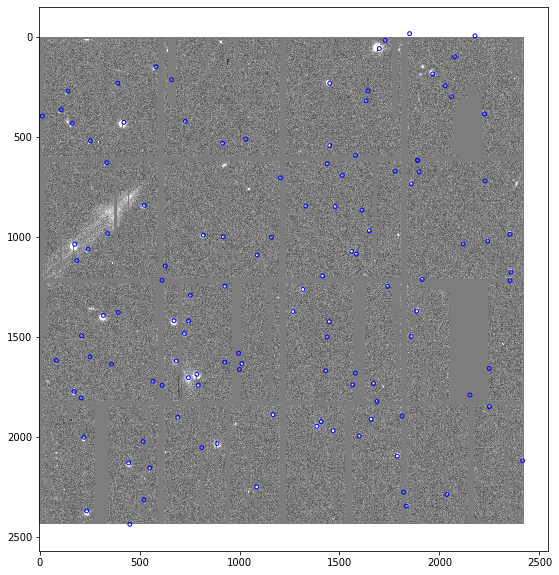

In [54]:
plt.figure(figsize = (500,500))
transform1 = approximate_transform(cord, np.shape(image_data), Focal_Length, CCDXPIXE, (RA_deg, DEC_deg),264.2)
plt.figure(figsize = (10,10))
plt.imshow(image_data, cmap = 'gray', vmin=image_data.mean() - 1*image_data.std(), vmax=image_data.mean() + 1*image_data.std())
plt.scatter(transform1[:,0], transform1[:,1], s = 15, facecolors='none', edgecolors='b')
plt.show()

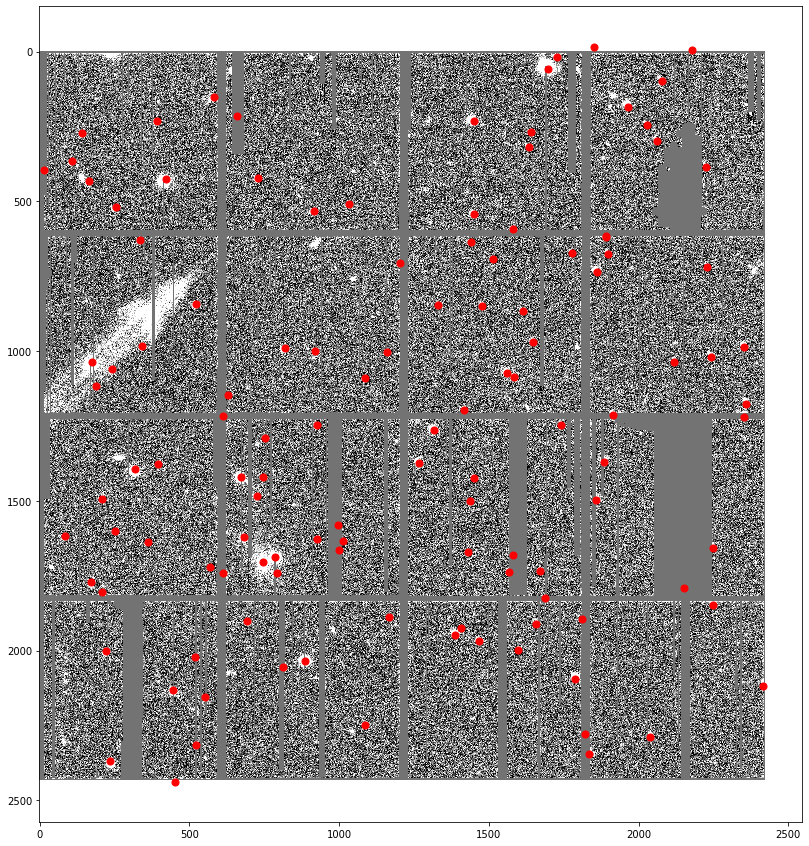

In [55]:
#plot all pixel cordinates on top of image
plt.figure(figsize=(15, 15))
plt.imshow(image_data, cmap='gray', vmin=image_data.mean()-0.2*image_data.std(), vmax=image_data.mean()+0.2*image_data.std())
plt.scatter(transform1[:,0], transform1[:,1],50, color = 'r')

plt.show()

###  Arushi- the GAIA has been able to identify some of the bigger spots as double stars, which was not possible in USNO. Please make a slide of this for your science fair 

 - Artash

In [56]:
def find_complete_star(image,x,y):

    centroided_coords = []
    
    #print(y)
    background = np.mean(image_data)
    
    
    for b,a in zip(x,y):
        a = int(a)
        b = int(b)
        n = 12
        square = image[a-n:a+n, b-n:b+n]
        
        weighted_x = []
        weighted_y = []
        
        for xc in range(len(square)):
            for yc in range(len(square[xc])):
                weighted_x.append((square[xc,yc]**1)*(a+xc))
                weighted_y.append((square[xc,yc]**1)*(b+yc))
                
        x_centroid = np.sum(weighted_x)/np.sum(square**1)
        y_centroid = np.sum(weighted_y)/np.sum(square**1)
        
        #plt.imshow(square)
        #plt.scatter([y_centroid],[x_centroid])
       # plt.show()
        
        print(x_centroid-n, y_centroid-n)
        centroided_coords.append([y_centroid-n, x_centroid-n])
        
    return centroided_coords
        

1261.4736975301644 1315.7116890785767
1372.3872619122324 1266.0409707474478
1088.8142475124966 1087.2515473074488
1194.274548517875 1415.21571105144
1001.563236521279 1159.29847556632
1245.7608795586884 925.9684130610425
1422.1574540772965 1448.2155232621737
1499.4259934568338 1437.4977494842567
998.1045742778169 918.107031235886
1070.0650825266107 1558.585464587814
844.5016197509004 1330.3153282762228
1084.1148646125116 1583.1605602240895
1580.5 994.5
992.949960514991 816.9504086032955
846.891094820334 1476.9568962063854
1632.7812907462574 1010.8169618638825
1291.0194217996632 752.3892008597487
1662.5 998.5
1624.6955520113415 925.5295577029323
967.1591865357643 1647.8091873063822
1668.4393367554965 1430.5386038828658
1420.2374614375703 744.3766648809413
703.5335661943802 1203.3353199075466
1245.052611052982 1739.4193569865881
865.2985123493421 1611.390615727762
1482.7901741624994 723.4358451819222
1423.1025140408128 670.6355383128615
1144.707613597129 627.5169022484018
1680.5 1578.5
1

C:\Users\vikas\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in double_scalars
C:\Users\vikas\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in double_scalars


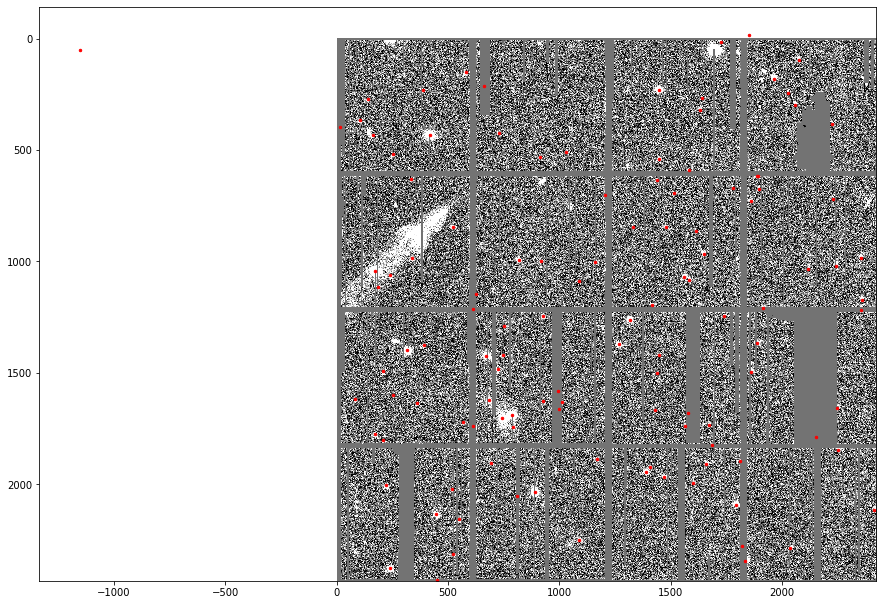

In [57]:
centroids = np.array(find_complete_star(image_data, transform1[:,0], transform1[:,1]))

#plot all pixel cordinates on top of image
plt.figure(figsize=(15, 15))

plt.imshow(image_data, cmap='gray', vmin=image_data.mean()-0.2*image_data.std(), vmax=image_data.mean()+0.2*image_data.std())
plt.scatter(centroids[:,0],centroids[:,1],6, color = 'r')

plt.show()

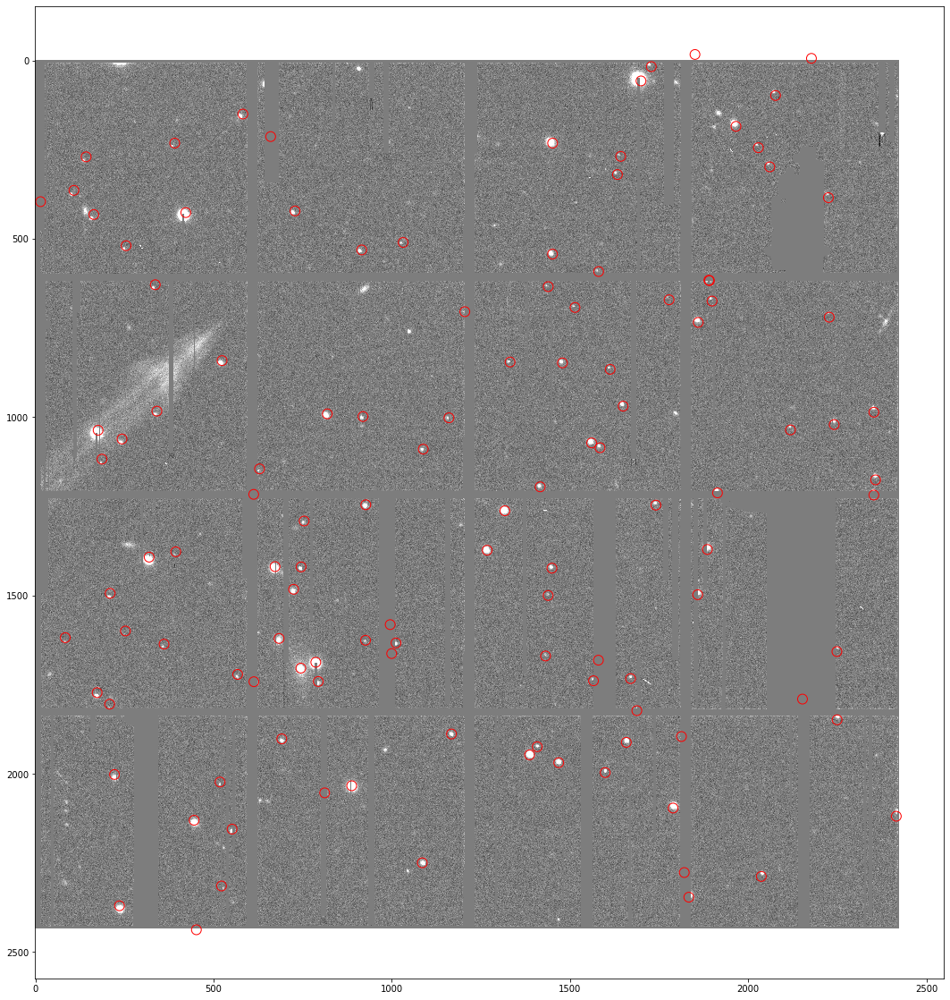

In [58]:
#plot all pixel cordinates on top of image
plt.figure(figsize=(20, 20))

plt.imshow(image_data, cmap='gray', vmin=image_data.mean()-1*image_data.std(), vmax=image_data.mean()+1*image_data.std())

#plt.scatter(star_x,star_y,5,color = 'b')
plt.scatter(transform1[:,0],transform1[:,1], s=120, facecolors='none', edgecolors='r')

In [59]:
centroids = transform1

## Step 3: Eliminating all Know Stars From Image

---------------------------------

### Creating Circular Mask for any Radius length

In [60]:
def area2radius(area):
    return round(((area/np.pi)**0.5)+5)

In [61]:
def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center <= radius
    return mask

### Creating Mask on every Star in Image

array([[160, 160, 160, ..., 160, 160, 160],
       [160, 160, 160, ..., 160, 160, 160],
       [160, 160, 160, ..., 160, 160, 160],
       ...,
       [160, 160, 160, ..., 160, 160, 160],
       [160, 160, 160, ..., 160, 160, 160],
       [160, 160, 160, ..., 160, 160, 160]], dtype=uint16)

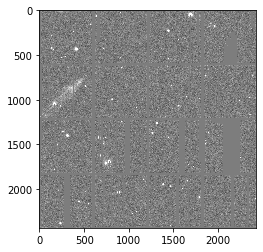

In [62]:
show(image_data)

a

In [63]:
import scipy.ndimage as ndimage


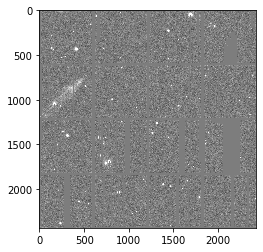

In [64]:
plt.imshow(image_data, cmap='gray', vmin=image_data.mean()-1*image_data.std(), vmax=image_data.mean()+1*image_data.std())

1262.7263817460212 1317.3440450766752


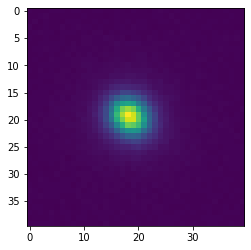

1373.321187487918 1267.620928291505


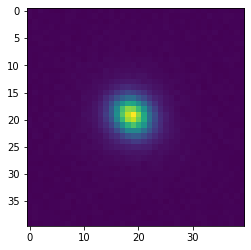

1089.9074273868414 1088.1276967248148


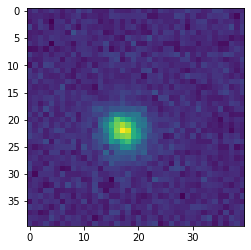

1195.6134222419569 1416.303840652573


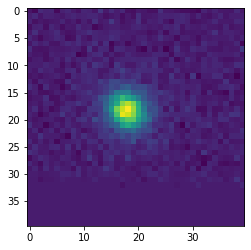

1002.0868217184706 1160.3190019103802


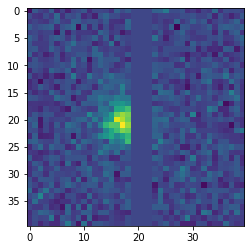

1245.861974125761 927.026876482896


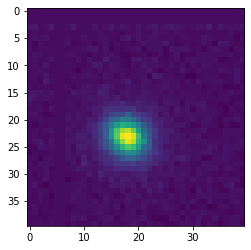

1423.6372462592544 1449.3200616965878


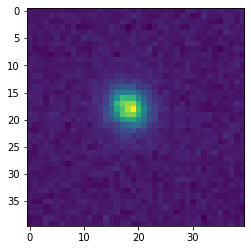

1500.1918561157179 1438.6078139366932


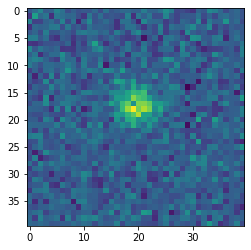

998.5503855669759 919.0890790864705


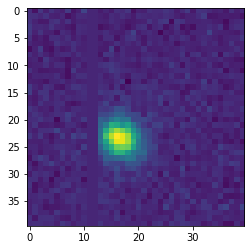

1072.4784670759536 1560.6804369811011


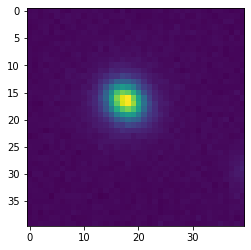

845.6971087413264 1331.8704538623747


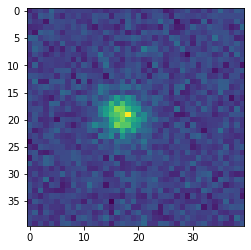

1085.9589022879895 1584.2928245744188


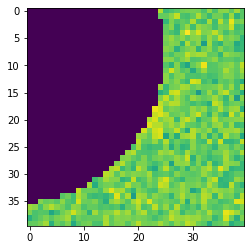

1581.8883063019762 995.4418505163549


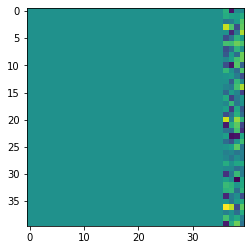

991.0373441841766 819.0625819068779


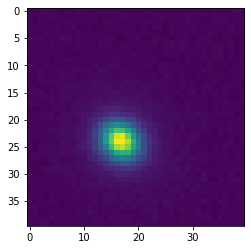

848.1315465261267 1478.8257488084405


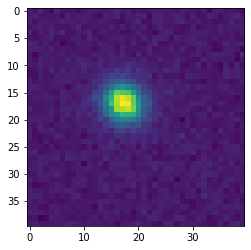

1633.219672181523 1011.741029117587


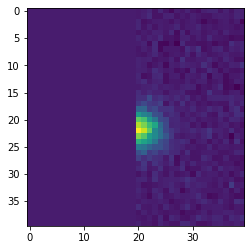

1291.4033043337884 753.9730774486586


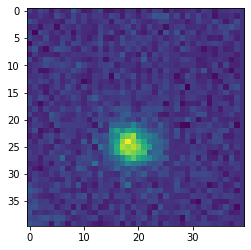

1663.0859758050956 999.5835155377522


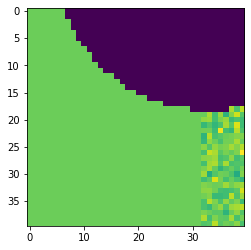

1625.8388391727765 926.2704882167326


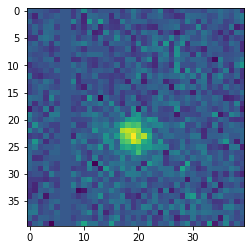

969.4013955818955 1649.1319521491082


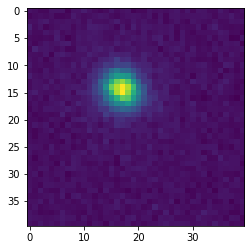

1669.8637472025173 1431.4358661620533


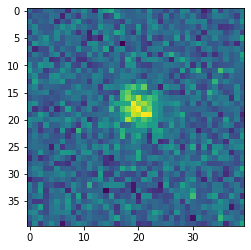

1420.0328714767106 745.4469172228642


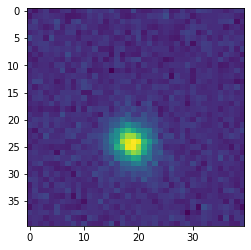

704.5191036471941 1204.9124570406452


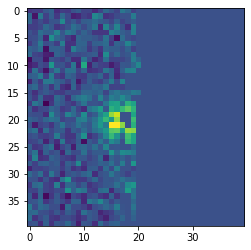

1246.9360948502294 1740.9877208494536


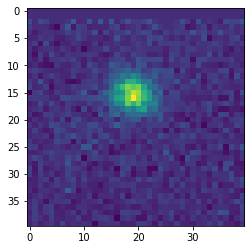

866.2069454929799 1612.7147884175533


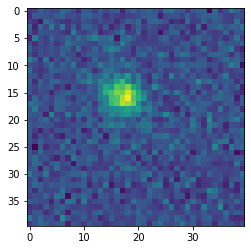

1482.8703718458842 724.4203906237049


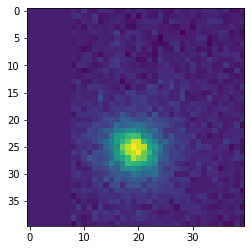

1419.2644930768652 672.4136503770932


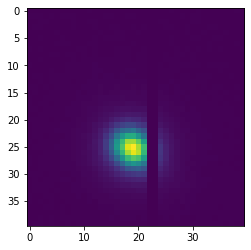

1145.2505974258927 628.7734624297242


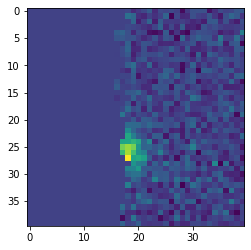

1681.590461726105 1579.6789435324274


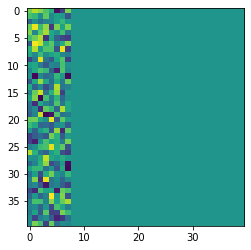

1216.6897324490906 612.4888185067799


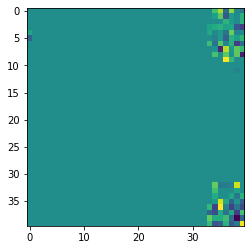

692.6868436649796 1514.0721236607405


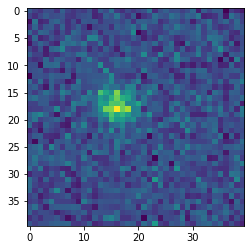

634.2654123180408 1438.8532786463552


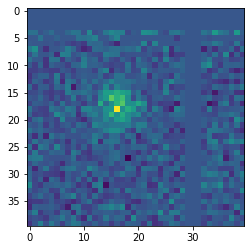

1739.32772999848 1565.920625380722


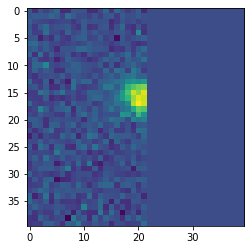

1687.4295399934833 786.6670134522149


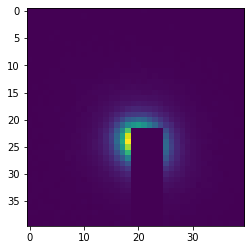

1620.7080114539283 683.6674120986619


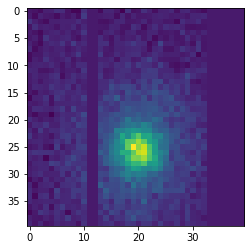

1741.335609814144 793.681413138562


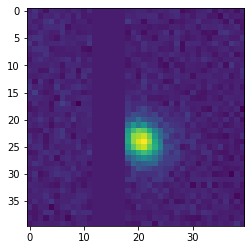

1888.5627801420446 1167.3369009362507


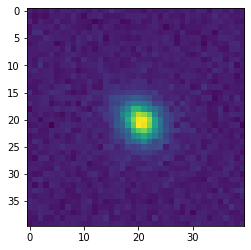

1703.9244664289206 744.6830434873416


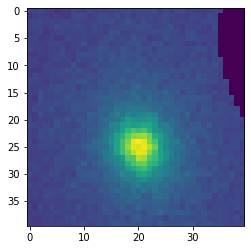

1733.2887751871954 1670.007461504448


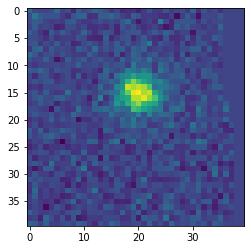

1371.1785040387886 1885.505416298548


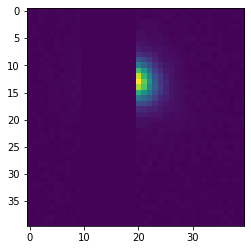

1212.634236318495 1913.8798555324358


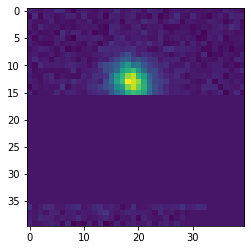

1498.0788044100773 1858.2655464290335


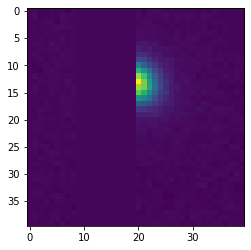

543.2050864077736 1450.9658580983062


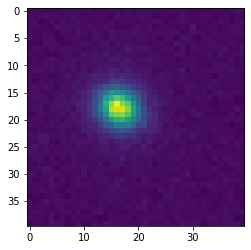

591.9773040997002 1580.3609412501426


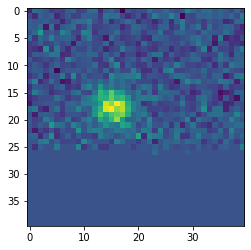

510.46289779579 1031.7554029139733


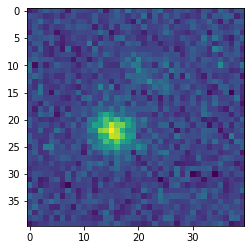

1924.3455670215417 1408.117855022969


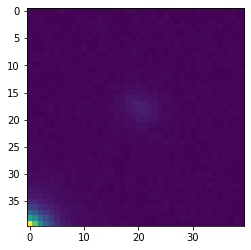

531.4316193685243 915.516622950758


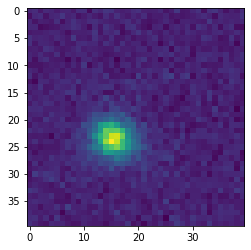

1947.0747889186505 1386.5917616294755


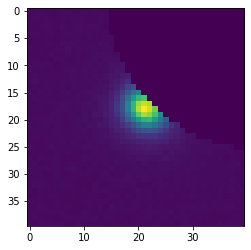

1823.111705936266 1687.5830211216887


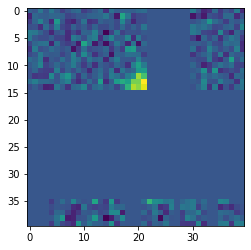

841.7409057894565 523.7039040301859


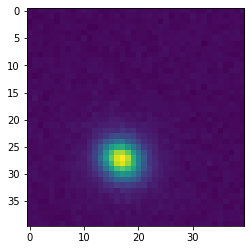

671.1609453967814 1778.0717458330168


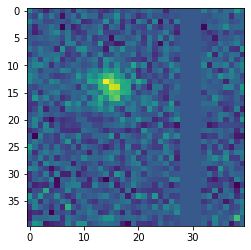

1968.9659905364722 1468.380754041584


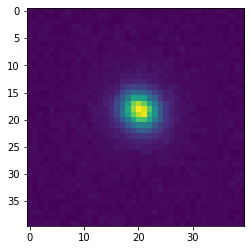

1741.9629158876019 613.033957270394


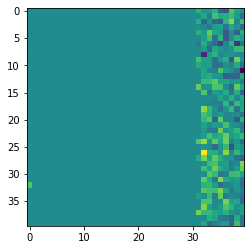

734.6257778621757 1859.882783475433


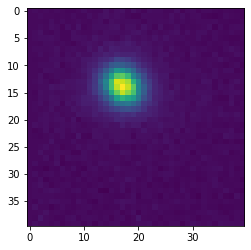

1721.4628470063267 567.3773225343531


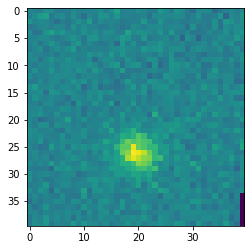

1912.011461414963 1657.9761250018016


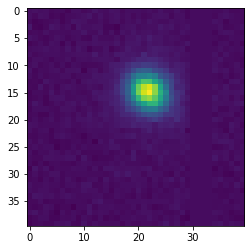

1377.6826682200199 393.70587550182654


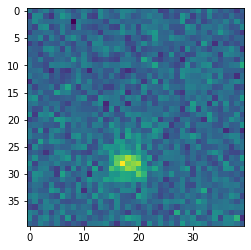

1902.2341631427685 691.2435817746249


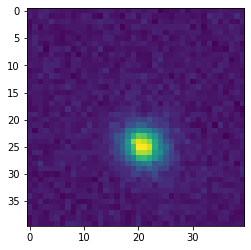

1996.7072843622736 1598.7880582443345


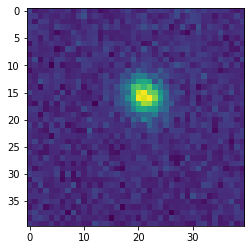

674.7979007826799 1898.6704692305443


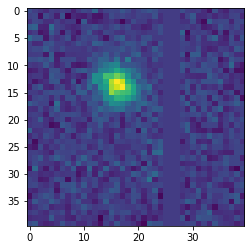

2033.6596410038965 887.4439426368298


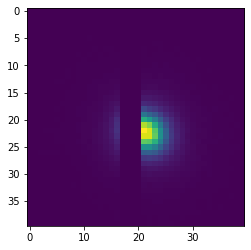

983.3893133595866 340.7868985769961


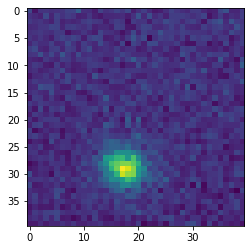

616.3134179480023 1889.6981489612826


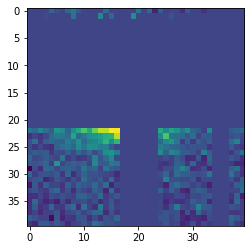

617.4952504618146 1891.31937317877


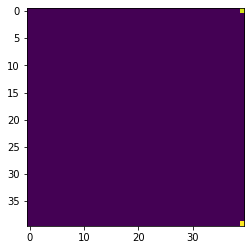

1895.6181328887844 1812.741803316314


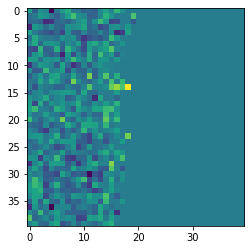

1392.7062883511283 319.07139569582876


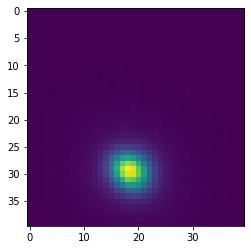

1036.0601285341163 2118.6383793752266


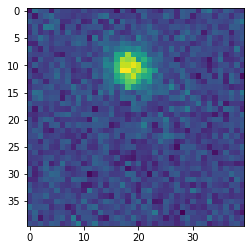

2053.5922361123553 811.6377922055021


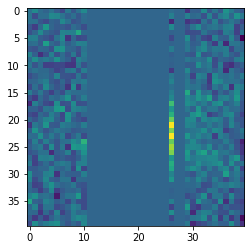

422.2103464997434 728.4748132037529


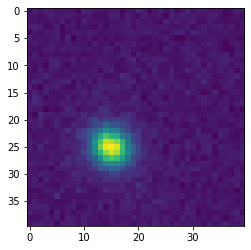

1636.6145719906053 360.92208882332136


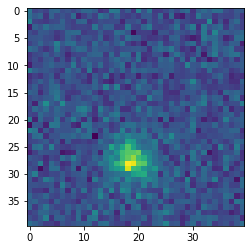

1061.520518769887 242.9092388747963


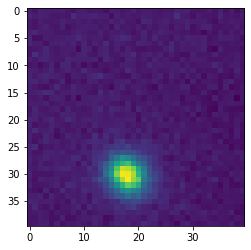

320.0036048389567 1633.1956255782616


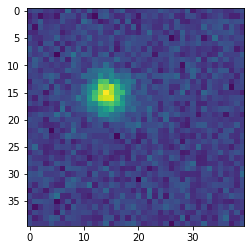

231.9475931658069 1451.224502326903


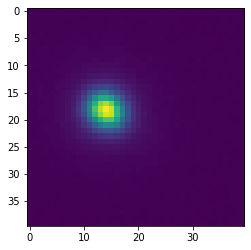

1117.9894031288397 186.6929178113619


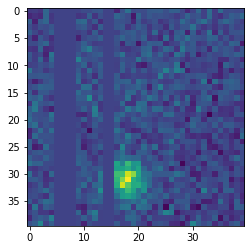

1599.6924509597006 252.58750218993794


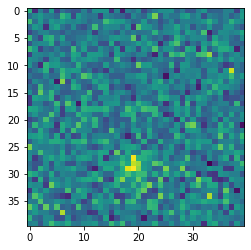

1494.1528936308778 209.6211864824205


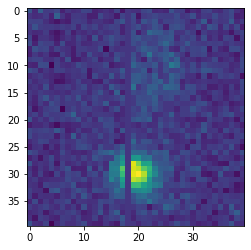

2249.7641153070335 1085.545503889842


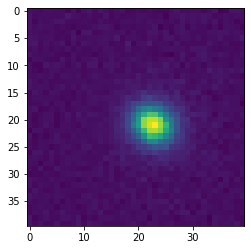

269.0925605216911 1642.3404873443706


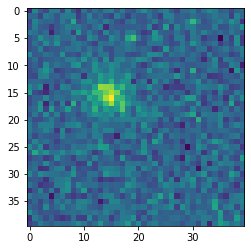

1021.1265074060796 2241.330600744972


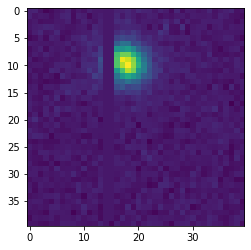

1036.9006990918724 175.87979262735917


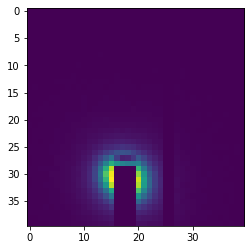

2096.2034525709187 1789.264574230074


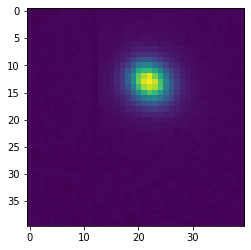

628.8835030015914 336.23417931386007


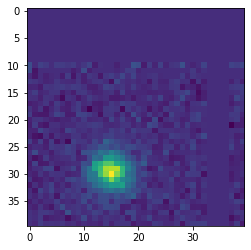

2023.1796032322968 518.0620943935211


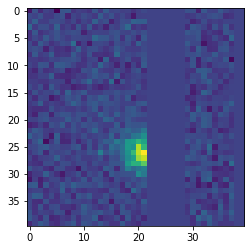

1790.6712073737317 2152.3918226087417


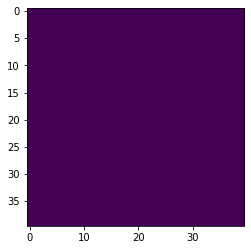

426.6839947355088 421.9418289206121


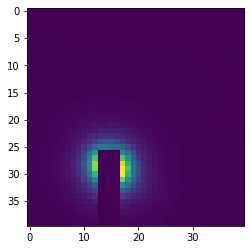

1657.466956264118 2248.9718612046117


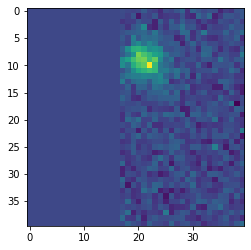

719.9840710565292 2227.5671786609855


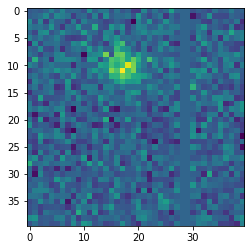

1218.5820950220077 2352.6676533937307


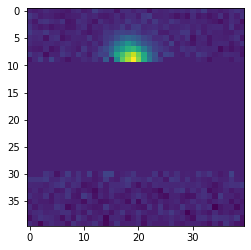

213.63788030081344 660.0666160601088


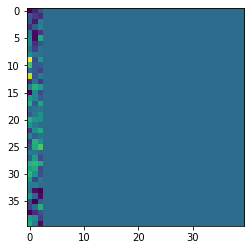

1176.0573435471154 2357.4405843730865


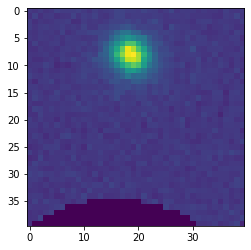

2155.21763584455 551.837940837677


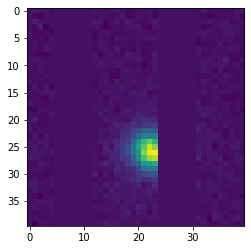

1804.937550832736 208.18315760315045


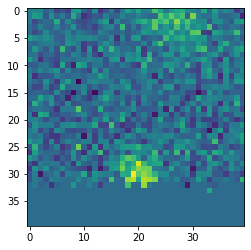

986.3929294500871 2352.7352844924962


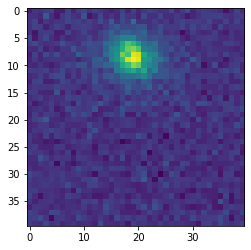

1772.6555158421797 173.09043901914015


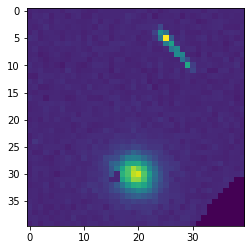

519.5577988262651 254.44220792122917


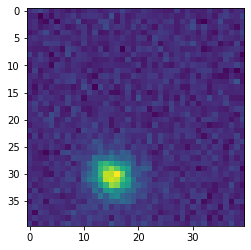

2130.3744763852146 445.27221596511527


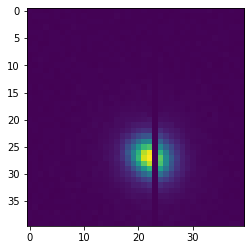

1618.472886149052 83.7312662528634


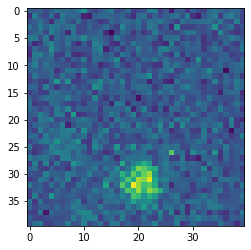

1848.8275568094236 2249.6132710248385


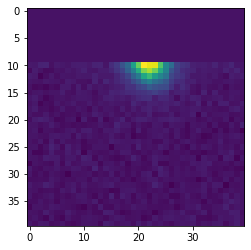

2276.9951520433533 1820.7064354379568


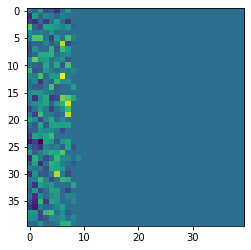

150.42628617482455 582.173916779724


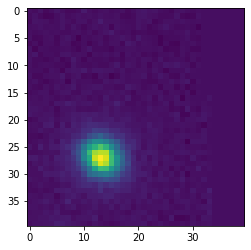

298.5478175955544 2060.6764888287503


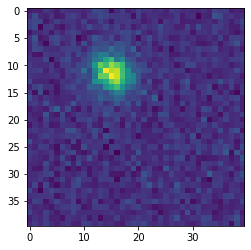

57.54638726113285 1699.2422436879112


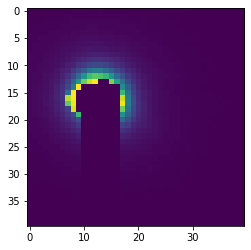

2002.0468037115083 221.80771443686615


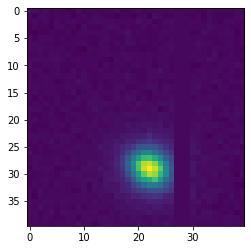

244.7705171985176 2028.6072435148121


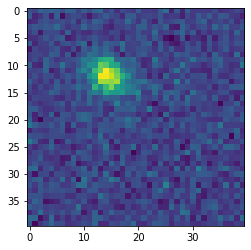

184.96326775842795 1965.7814032800684


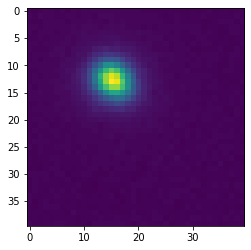

231.9010664994321 390.883352887009


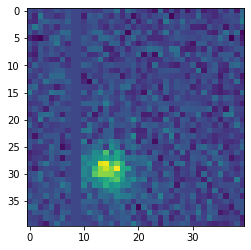

2346.1285639761354 1833.4182544842633


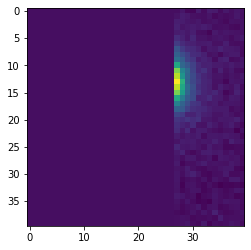

2314.636315213699 522.1948860632274


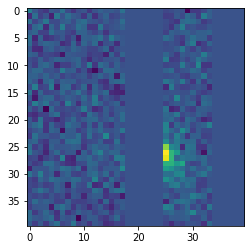

17.577217882063223 1728.139819444726


C:\Users\vikas\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  # This is added back by InteractiveShellApp.init_path()


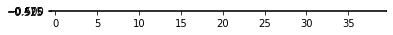

432.09616402453287 163.88922832357275


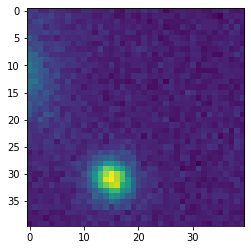

384.8733009169458 2225.118572041557


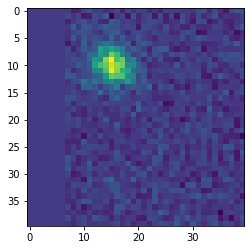

2287.8892220992366 2036.8844651272104


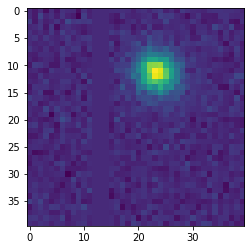

-16.560096028225416 1850.7208859499056


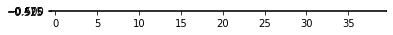

364.3736929036629 107.89670715375587


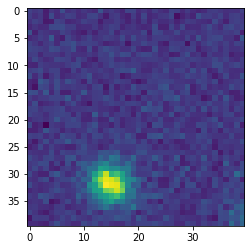

98.45770777340203 2076.6960748407773


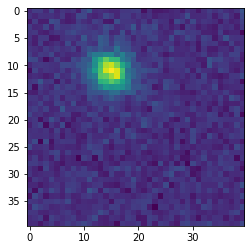

270.37060649601017 142.26342459109037


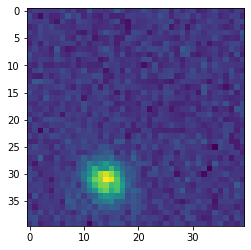

2437.4809659017683 451.6519693037752


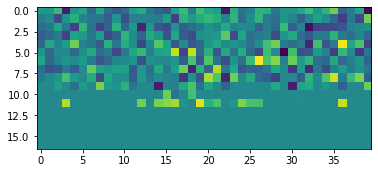

396.07223840657207 14.422057152914022


C:\Users\vikas\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  # This is added back by InteractiveShellApp.init_path()


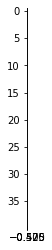

2119.1966605759744 2415.6016911990937


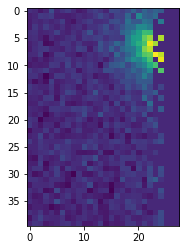

2370.2019457363335 235.84824731434867


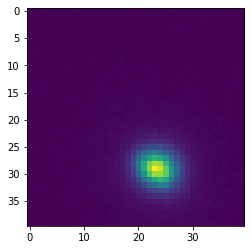

-5.668837252683488 2177.4682693471686


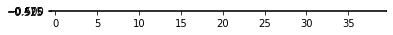

In [65]:
NEW_IMAGE = np.copy(image_data)
#NEW_IMAGE = ndimage.rotate(image_data, 90, reshape=True)

a = []
for coordinate in centroids:
    try:
        y,x = coordinate
        
        sub = NEW_IMAGE[int(x-20):int(x+20),int(y-20):int(y+20)]
        print(x,y)
        plt.imshow(sub)
        plt.show()
        radius = (area2radius(np.sum(sub>100)))
        sample_mask = create_circular_mask(40,40, center = (20,20), radius=radius)
        mask = np.invert(create_circular_mask(NEW_IMAGE.shape[0],NEW_IMAGE.shape[1], center = (y,x), radius=radius))
        NEW_IMAGE*=mask
       
    except:
        continue
a = np.array(a)

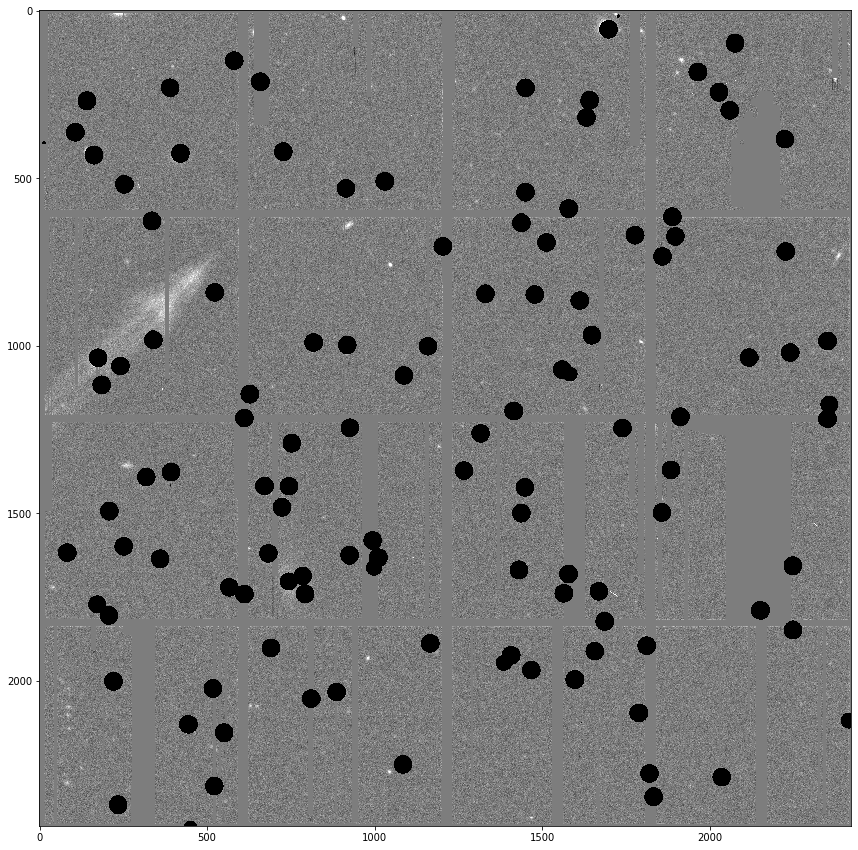

In [66]:
plt.figure(figsize=(15,15))
show(NEW_IMAGE)


In [67]:
def scale(im):
    VMIN = image_data.mean()-2*image_data.std()
    VMAX = image_data.mean()+2*image_data.std()
    
    # Mostly to clip hot pixels / extraneous values / noise
    # Sets pixels above VMAX to VMAX
    return np.clip(im, VMIN, VMAX)

In [68]:
IMAGE_SCALED = scale(NEW_IMAGE)

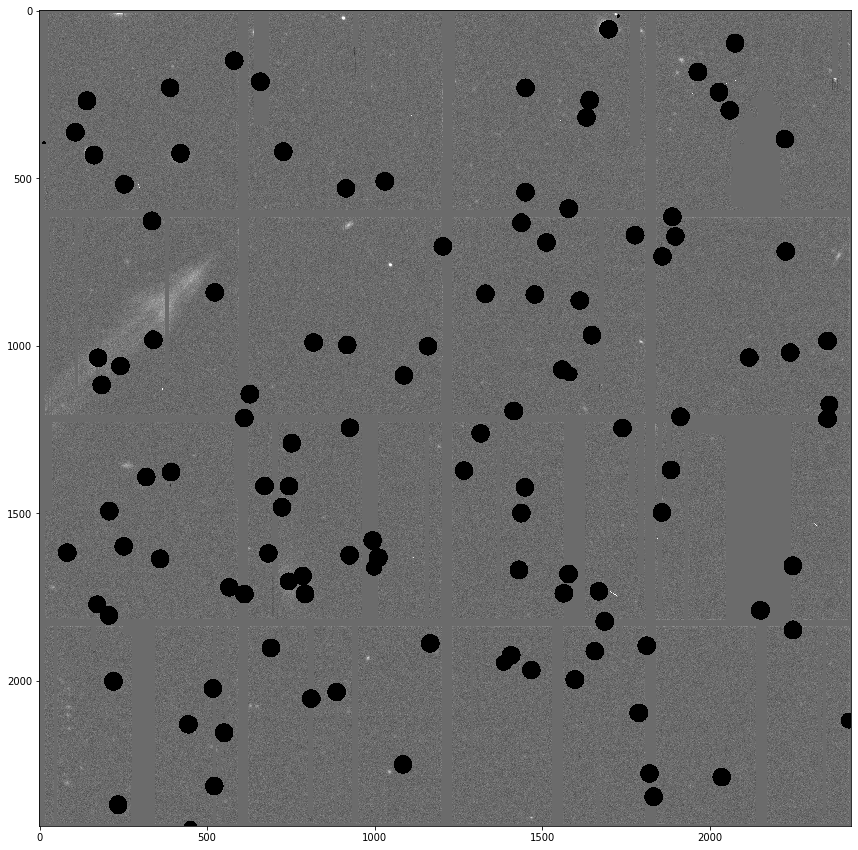

In [69]:
plt.figure(figsize=(15,15))
plt.imshow(IMAGE_SCALED, cmap='gray')

In [70]:
COORDINATES = []
STDS = []
MEANS = []

threshold = np.mean(IMAGE_SCALED) + (np.std(IMAGE_SCALED)*9)
threshold = 330
for y_p in tqdm(range(len(IMAGE_SCALED))[15:-15]):
    for x_p in range(len(IMAGE_SCALED[0]))[15:-15]:        
        
        try:
            pixel_brightness = IMAGE_SCALED[x_p, y_p]
        except:
            continue
            
        if pixel_brightness > (threshold):
            print(pixel_brightness)
            mask_coordinates = []
            for x_i in range(x_p-6, x_p+7):
                for y_i in range(y_p-6, y_p+7):
                    mask_coordinates.append([x_i, y_i])
                    
            mask_values = [IMAGE_SCALED[c[0], c[1]] for c in mask_coordinates]
            
            STD = np.std(mask_values)
            MEAN = np.mean(mask_values)
            
            COORDINATES.append([x_p, y_p])
            STDS.append(STD)
            MEANS.append(MEAN)
            
COORDINATES = np.array(COORDINATES)
STDS = np.array(STDS)

332.0
381.18912423115523
356.0
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
366.0
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115523
354.0
340.0
381.18912423115523
339.0
381.18912423115523
380.0
347.0
360.0
381.18912423115523
381.18912423115523
381.18912423115523
381.18912423115

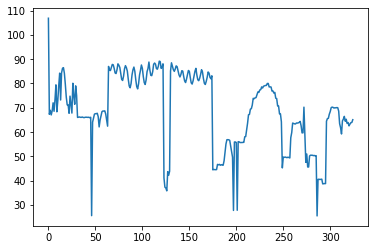

In [71]:
plt.plot(STDS)

In [72]:
COORDINATES2 = COORDINATES[STDS>(np.mean(STDS))]
STDS2 = STDS[STDS>np.mean(STDS)]

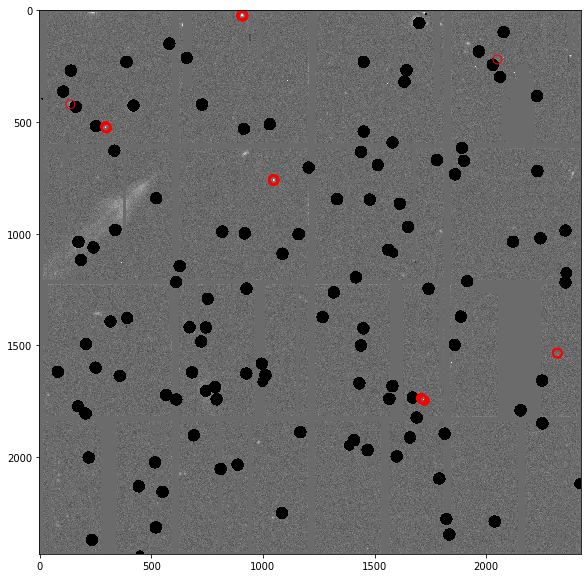

In [73]:
plt.figure(figsize=(10,10))
plt.imshow(IMAGE_SCALED, cmap='gray')
plt.scatter(COORDINATES2[:,1], COORDINATES2[:,0], s=80, facecolors='none', edgecolors='r')

In [74]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

X = StandardScaler().fit_transform(COORDINATES2)

db = DBSCAN(eps=0.1, min_samples=1).fit(X)
LABELS = db.labels_

CENTROIDS = []
for cluster_n in range(LABELS.max()+1):
    
        CENTROIDS.append( np.mean(COORDINATES2[LABELS==cluster_n], axis=0) )

CENTROIDS = np.array(CENTROIDS)

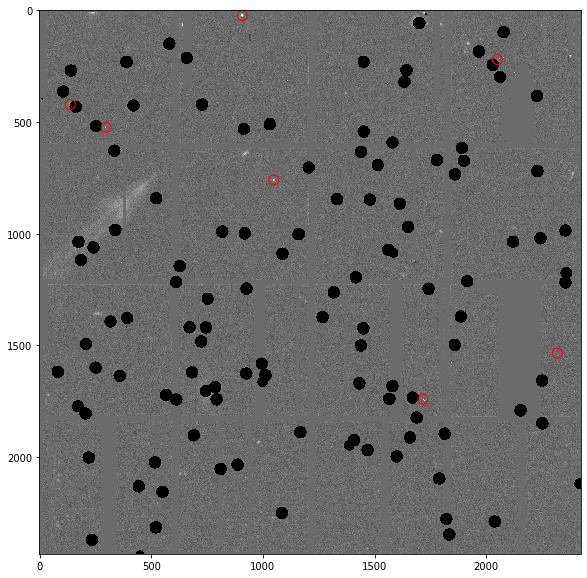

In [75]:
plt.figure(figsize=(10,10))
plt.imshow(IMAGE_SCALED, cmap='gray')
plt.scatter(CENTROIDS[:,1], CENTROIDS[:,0], s=100, facecolors='none', edgecolors='r')

983


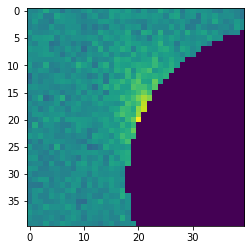

1460


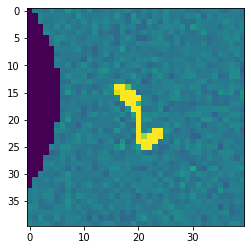

1600


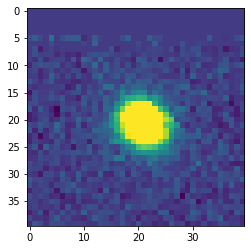

1600


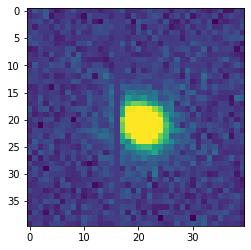

1563


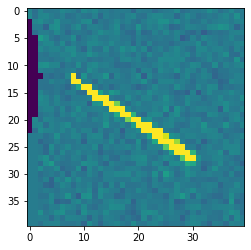

1150


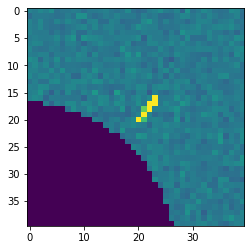

1600


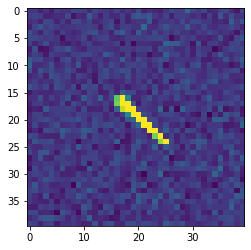

In [76]:
FINAL_COORDINATES = []
for coordinate in CENTROIDS:
    try:
        x, y = coordinate
        sub = IMAGE_SCALED[int(x-20):int(x+20),int(y-20):int(y+20)]
        threshold = 1
        num_brightpix = np.sum(sub>(threshold))
        print(num_brightpix)

        plt.imshow(sub)
        plt.show()
        if num_brightpix>10:
            FINAL_COORDINATES.append((x,y))
    except:
        continue 
        
FINAL_COORDINATES = np.array(FINAL_COORDINATES)

In [77]:
FINAL_COORDINATES

array([[ 421.        ,  138.        ],
       [ 524.36363636,  297.54545455],
       [  23.66101695,  907.84745763],
       [ 759.8       , 1047.82222222],
       [1741.90322581, 1716.58064516],
       [ 220.        , 2050.        ],
       [1535.        , 2318.5       ]])

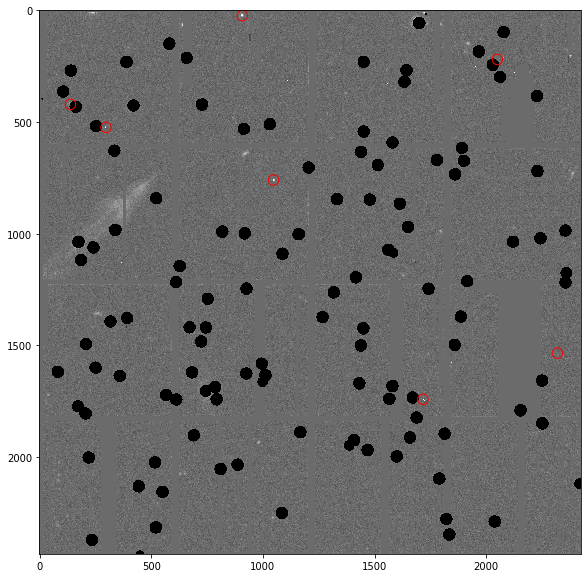

In [78]:
plt.figure(figsize=(10,10))
plt.imshow(IMAGE_SCALED, cmap='gray')
plt.scatter(FINAL_COORDINATES[:,1], FINAL_COORDINATES[:,0], s=110, facecolors='none', edgecolors='r')

In [79]:
STDS[0]

106.85322245056086

In [80]:
import plotly.express as px
import pandas as pd


df = pd.DataFrame(dict(
    std = STDS,
    mean = MEANS
))
#df = df.sort_values(by="mean")

fig = px.line(df, y='std', title='Test')
fig.show()

In [81]:
import os # Help with file directories
mag_limit = 21
def known_asteroid_finder(date, time, fov1, fov2, mpc, ra, dec): #Date: year-month-day   Time: hh:mm:ss   FOV1: arcmin_start to end ra   FOV2: arcmin_start to end dec   MPC code: observatory minor planet center code

    sep = ''
    mpc_mod = sep.join("&mpc-code=" + mpc)
    date_mod = sep.join("&obs-time=" + date)
    time_mod = sep.join("_" + time)
    fov1_mod = sep.join("&fov-ra-center=" + ra)
    fov2_mod = sep.join("&fov-dec-center=" + dec)
    ra_mod = sep.join("&fov-ra-hwidth=" + fov2)
    dec_mod = sep.join("&fov-dec-hwidth=" + fov1)
    mag_mod = sep.join("&vmag-lim=" + str(mag_limit))
   
    start = 'https://ssd-api.jpl.nasa.gov/sb_ident.api?sb-kind=a&mag-required=true&two-pass=true&suppress-first-pass=true&req-elem=false'
    link = start, mpc_mod, date_mod, time_mod, fov1_mod, fov2_mod, ra_mod, dec_mod, mag_mod
    link = sep.join(link)
    return link

In [82]:
DATE

'2021-08-06T10:55:06.783824'

In [83]:
FOV1 = FOV
FOV2 = FOV

In [84]:
date, time = DATE.split('T')
fov1 = str((FOV/60)/2)
fov2 = str((FOV2/60)/2)
mpc = 'F51'

In [85]:
a,b,c = time.split(':')
if len(c)>2:
    c = c[0]+c[1]
    time = a,':', b,':',c
    time = ''.join(time)

In [86]:
time


'10:55:06'

In [87]:
def convert(ra,dec):
    if '+' in dec:
        dec = dec.replace("+", "")
    if '-' in dec:
        dec = dec.replace("+", "m")
    if '/' in dec:
        dec = dec.replace("/", "")

    ra1 = ra.split(' ')
    dec1 = dec.split(' ')
    sep = '-'
    ra = sep.join(ra1)
    dec = sep.join(dec1)
    return ra,dec

In [88]:
ra,dec = convert(RA,DEC)

In [89]:
ra

'22-57-33.2'

In [90]:
asteroids = known_asteroid_finder(date, time, fov1, fov2, mpc, ra, dec)

In [91]:
fov1

'0.08666666666666667'

In [92]:
asteroids

'https://ssd-api.jpl.nasa.gov/sb_ident.api?sb-kind=a&mag-required=true&two-pass=true&suppress-first-pass=true&req-elem=false&mpc-code=F51&obs-time=2021-08-06_10:55:06&fov-ra-center=22-57-33.2&fov-dec-center=-11-52-38&fov-ra-hwidth=0.08666666666666667&fov-dec-hwidth=0.08666666666666667&vmag-lim=21'

In [93]:
import requests
import json
response_API = requests.get(asteroids)
data = response_API.text

In [94]:
data

'{"signature":{"source":"NASA/JPL Small-Body Identification API","version":"1.1"},"summary":{"fov-ra-center":"22-57-33.2","req-elem":"false","obs-time":"2021-08-06 10:55:06","fov-dec-center":"-11-52-38","suppress-first-pass":"true","two-pass":"true","mag-required":"true","vmag-lim":"21","mpc-code":"F51","fov-dec-hwidth":"0.08666666666666667","fov-ra-hwidth":"0.08666666666666667"},"sb_constraints":{"sb-kind":"a"},"fields_second":["Object name","Astrometric RA (hh:mm:ss)","Astrometric Dec (dd mm\'ss\\")","Dist. from center RA (\\")","Dist. from center Dec (\\")","Dist. from center Norm (\\")","Visual magnitude (V)","RA rate (\\"/h)","Dec rate (\\"/h)"],"observer":{"location":"Pan-STARRS 1, Haleakala","obs_date":"2021-Aug-06 10:55:05 (2459432.954931 UT)","fov_offset":"00:00:20.80, +00 05\'12.00\\"","fov_center":"22:57:33.20, -11 52\'38.00\\" (J2000)"},"n_second_pass": 1,"data_second_pass":[["148932 (2001 XR92)","22:57:41.43","-11 53\'06.6\\"","121.","-28.6","123.4","18.5","-2.098E+01","-8

In [95]:
data = data.split('[')

In [96]:
num = len(data) - 3

In [97]:
num

1

In [98]:
asteroids = []
for i in range(num):
    ast = data[i + 3]
    ast = ast.split(',')
    x,y = convert(ast[1],ast[2])
    print(x,y)
    asteroids.append([x,y])
    print(asteroids)

"22:57:41.43" "-11-53'06.6\""
[['"22:57:41.43"', '"-11-53\'06.6\\""']]


In [99]:
def convert(ra,dec):
    ra = str(ra)
    dec = str(dec)
    if '+' in dec:
        dec = dec.replace("+", "")
    if '-' in dec:
        dec = dec.replace("-", "m")
  

    ra1 = ra.split(' ')
    dec1 = dec.split(' ')
    sep = '-'
    ra = sep.join(ra1)
    dec = sep.join(dec1)
    return ra,dec

In [100]:
x

'"22:57:41.43"'

In [101]:
convert(x,y)

('"22:57:41.43"', '"m11m53\'06.6\\""')

In [102]:
asteroids

[['"22:57:41.43"', '"-11-53\'06.6\\""']]

In [103]:
known_asteroids_celestial = []

for a,b in asteroids:
    neg = 0
    x1 = []
    y1 = []
    for i in a:
        try:
            i = int(i)
            x1.append(str(i))
            
        except:
            pass
        
    x1.insert(2, ' ')
    x1.insert(5, ' ')
    if len(a)>8:
        x1.insert(8, '.')
    print(x1)
    x1 = ''.join(str(e) for e in x1)
   
    if b[1] == '-':
        
        neg = 1
    for i2 in b:
        try:
            y1.append(int(i2))
        except:
            pass
        
    y1.insert(2, ' ')
    y1.insert(5, ' ')
    if len(b)>8:
        y1.insert(8, '.')
 
    if neg == 1:
        print(1)
        y1.insert(0, '-')
    y1 = ''.join(str(e) for e in y1)
    
    known_asteroids_celestial.append([x1,y1])

['2', '2', ' ', '5', '7', ' ', '4', '1', '.', '4', '3']
1


In [104]:
a

'"22:57:41.43"'

In [105]:
y1

'-11 53 06.6'

In [106]:
known_asteroids_celestial

[['22 57 41.43', '-11 53 06.6']]

In [107]:
ra

'22-57-33.2'

In [108]:
know_asteroids_ccd = []
for y,z in known_asteroids_celestial:
    
    know_asteroids_ccd.append([RAtoDeg(y), DECtoDeg(z)]) 
know_asteroids_ccd= np.array(know_asteroids_ccd)

344.422625
-11.885166666666667


In [109]:
know_asteroids_ccd

array([[344.422625  , -11.88516667]])

In [110]:
cords = []
for i in range(len(know_asteroids_ccd)):
   
    cords.append([know_asteroids_ccd[:,0][i], know_asteroids_ccd[:,1][i]])
    cord = np.array(cords)

In [111]:
DEC_deg

-11.877222222222223

In [112]:
cord

array([[344.422625  , -11.88516667]])

<class 'numpy.float64'>


<Figure size 36000x36000 with 0 Axes>

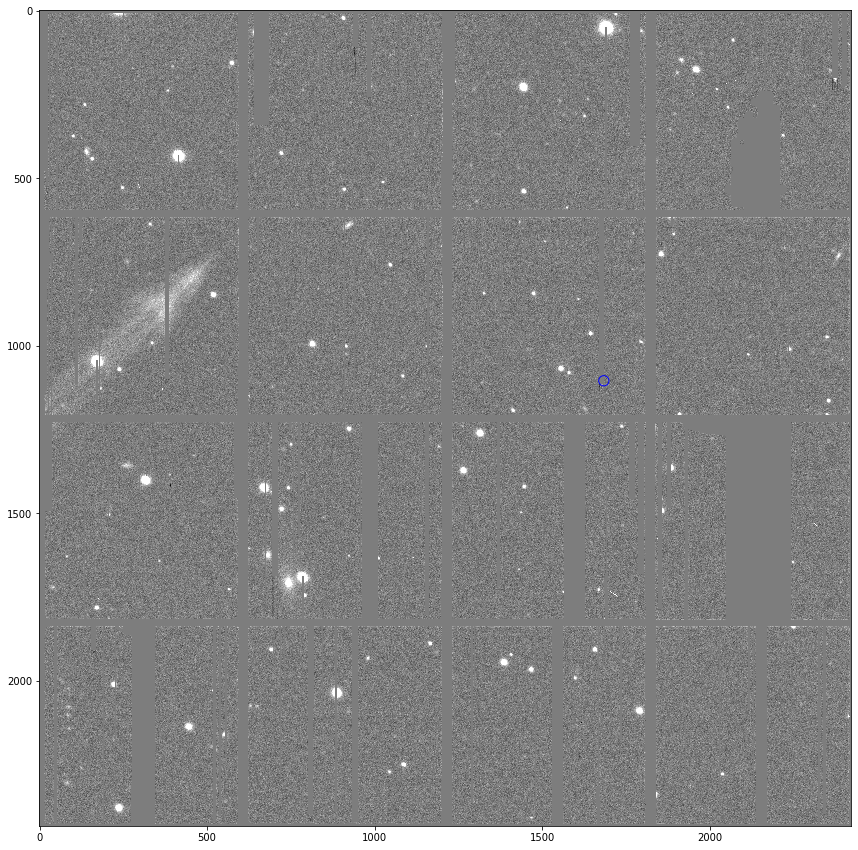

In [113]:
plt.figure(figsize = (500,500))
asteroids1 = approximate_transform(cord, np.shape(image_data), Focal_Length, CCDXPIXE, (RA_deg, DEC_deg), 0)
plt.figure(figsize = (15,15))
plt.imshow(image_data, cmap = 'gray', vmin=image_data.mean() - 1*image_data.std(), vmax=image_data.mean() + 1*image_data.std())
plt.scatter(asteroids1[:,0], asteroids1[:,1], s = 105, facecolors='none', edgecolors='b')
plt.show()

In [114]:
asteroids1

array([[1684.13735689, 1105.07490292]])

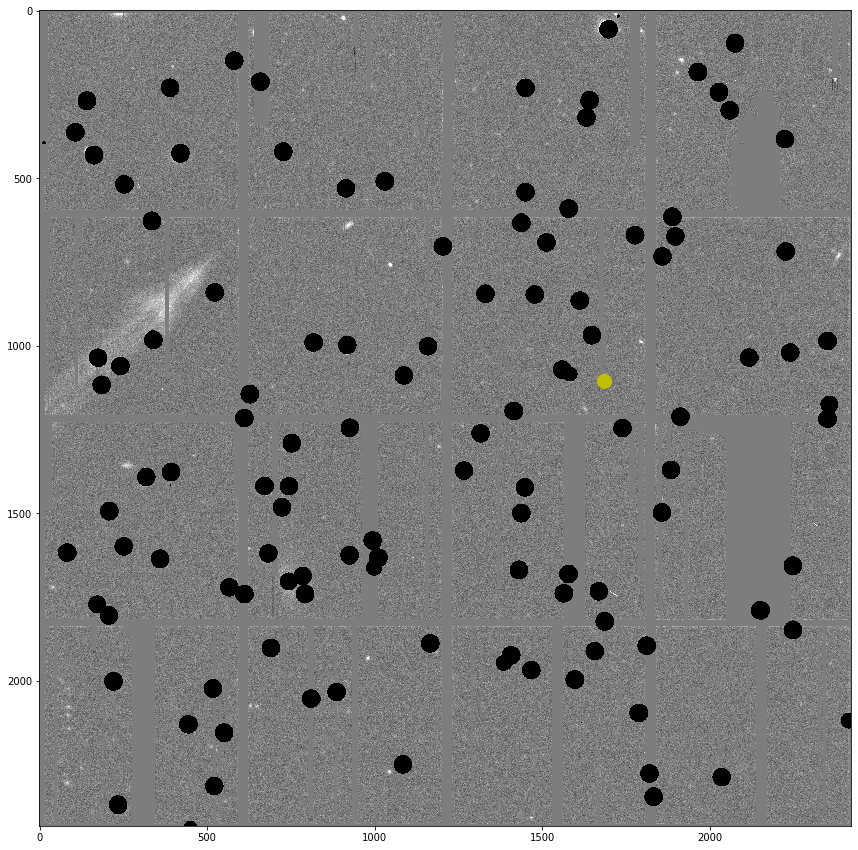

In [128]:
plt.figure(figsize=(15,15))

show(IMAGE_SCALED)
plt.scatter(asteroids1[:,0], asteroids1[:,1], 200, color = 'y')


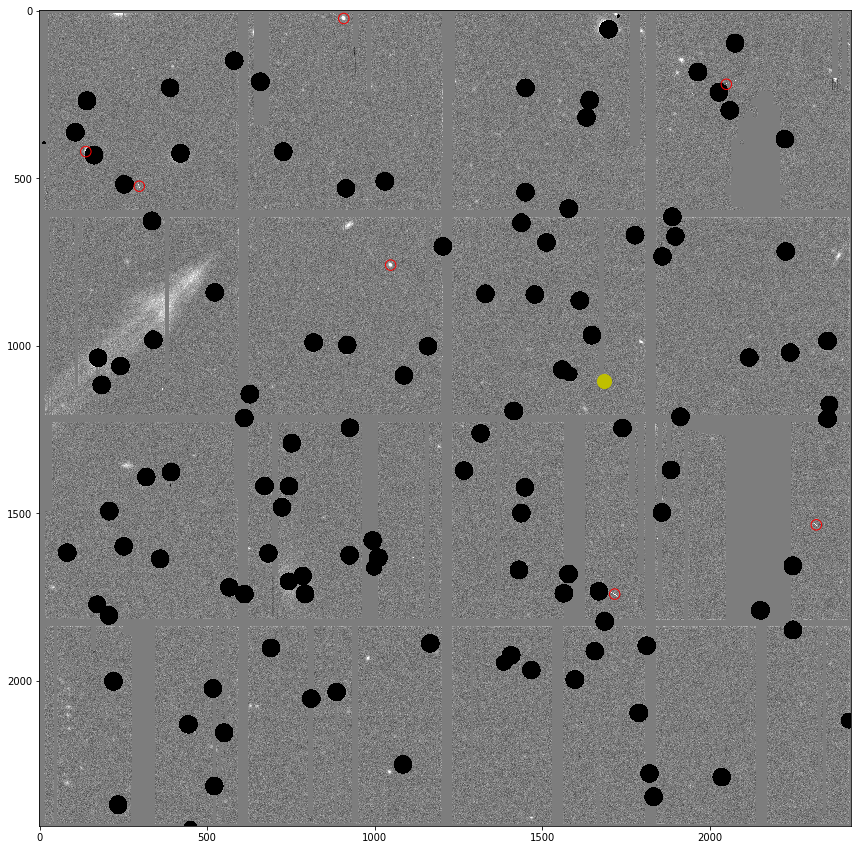

In [115]:
plt.figure(figsize=(15,15))

show(IMAGE_SCALED)
plt.scatter(FINAL_COORDINATES[:,1], FINAL_COORDINATES[:,0], s=110, facecolors='none', edgecolors='r')
plt.scatter(asteroids1[:,0], asteroids1[:,1], 200, color = 'y')


In [116]:
FINAL_COORDINATES

array([[ 421.        ,  138.        ],
       [ 524.36363636,  297.54545455],
       [  23.66101695,  907.84745763],
       [ 759.8       , 1047.82222222],
       [1741.90322581, 1716.58064516],
       [ 220.        , 2050.        ],
       [1535.        , 2318.5       ]])

In [117]:
FINAL_COORDINATES2 = []
for a in zip(FINAL_COORDINATES[:,1], FINAL_COORDINATES[:,0]):

    for a1 in zip(asteroids1[:,0], asteroids1[:,1]):
        print(abs(int(a[0])-int(a1[0])))
        if abs(int(a[0])-int(a1[0])) > 50 or (abs(int(a[1])-int(a1[1]))) > 50:
            print(1)
            FINAL_COORDINATES2.append([a[0], a[1]])
            

1546
1
1387
1
777
1
637
1
32
1
366
1
634
1


In [118]:
for a in asteroids1[:,0], asteroids1[:,1]:
    print(a1)

(1684.1373568924191, 1105.074902918358)
(1684.1373568924191, 1105.074902918358)


In [119]:
FINAL_COORDINATES2

[[138.0, 421.0],
 [297.54545454545456, 524.3636363636364],
 [907.8474576271186, 23.661016949152543],
 [1047.8222222222223, 759.8],
 [1716.5806451612902, 1741.9032258064517],
 [2050.0, 220.0],
 [2318.5, 1535.0]]

In [120]:
FINAL_COORDINATES2 = np.array(FINAL_COORDINATES2)

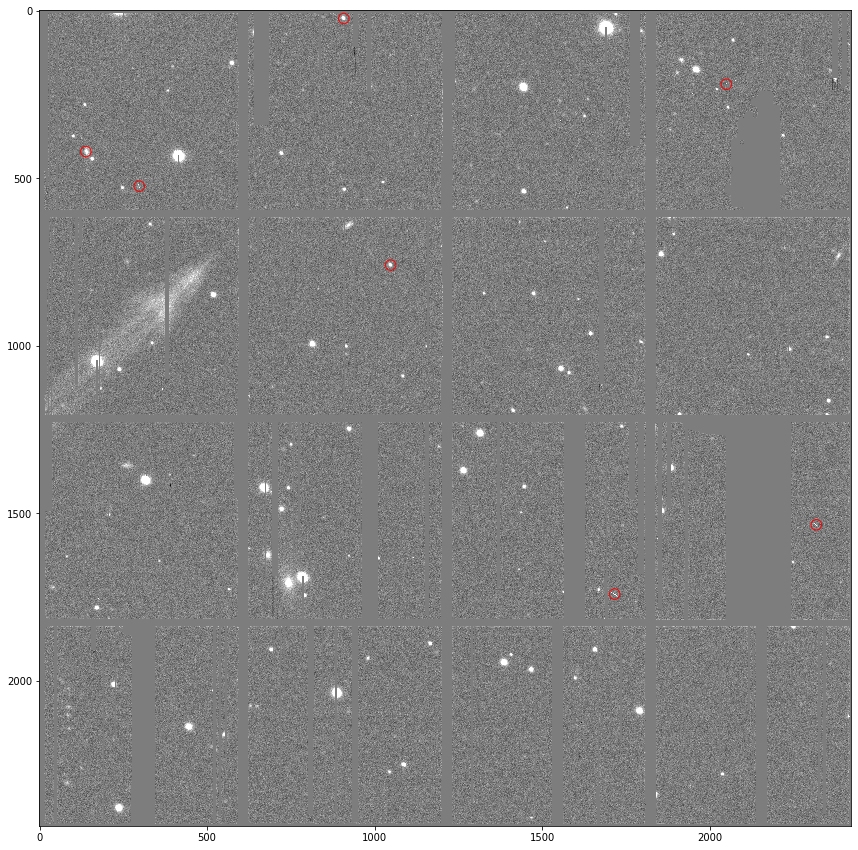

In [121]:
plt.figure(figsize=(15,15))

show(image_data)
plt.scatter(FINAL_COORDINATES2[:,0], FINAL_COORDINATES2[:,1], s=110, facecolors='none', edgecolors='r')

In [122]:
IMAGE = scale(image_data)

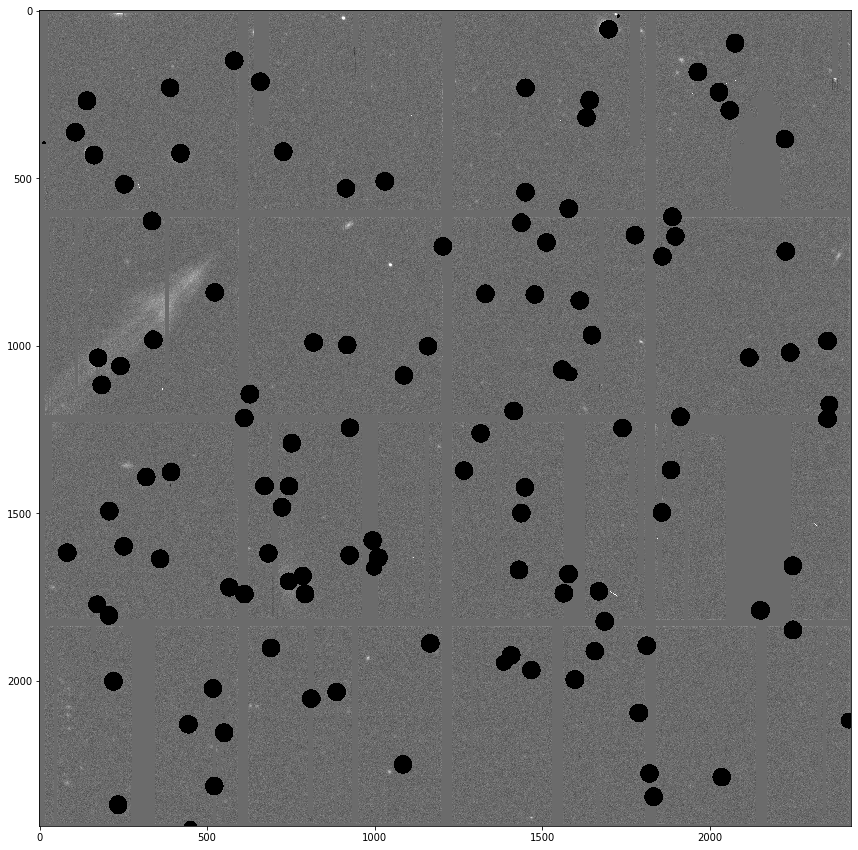

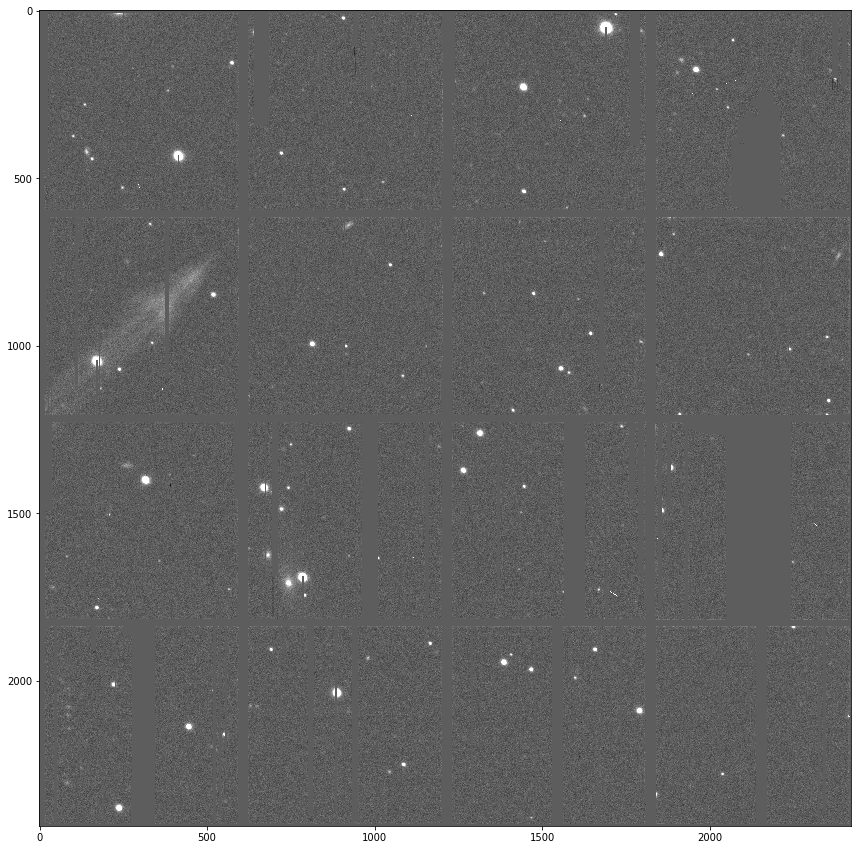

In [123]:
plt.figure(figsize=(15,15))

plt.imshow(IMAGE_SCALED, cmap = 'gray')

plt.show()

plt.figure(figsize=(15,15))

plt.imshow(IMAGE, cmap = 'gray')

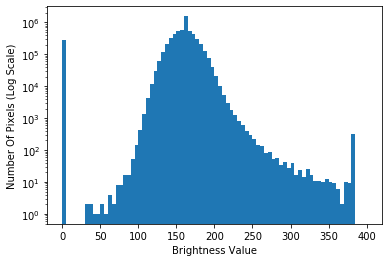

In [124]:
plt.hist(IMAGE_SCALED.ravel(), bins=80, range=(0.0, 400)) #calculating histogram
plt.ylabel('Number Of Pixels (Log Scale)')
plt.xlabel('Brightness Value')
plt.yscale('log')

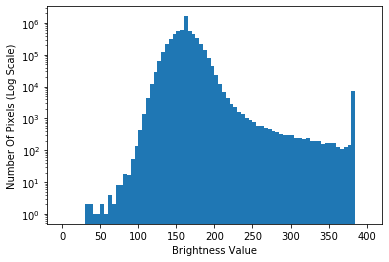

In [125]:
plt.hist(IMAGE.ravel(), bins=80, range=(0.0, 400)) #calculating histogram
plt.ylabel('Number Of Pixels (Log Scale)')
plt.xlabel('Brightness Value')

plt.yscale('log')